In [4]:
import numpy as np
import seaborn as sns
import pandas as pd
from scipy import stats
import pandas_profiling
import missingno as msno
import re
import datetime
from collections import Counter
from tqdm import tqdm
from pprint import pprint

import matplotlib
import matplotlib.pyplot as plt

%config InlineBackend.figure_format = 'retina'
%matplotlib inline

plt.style.use('fivethirtyeight')

In [5]:
df = pd.read_csv('./datasets/cleaned-df.csv')

In [6]:
df.head()

,order_id,price,freight_value,product_name_len,product_description_len,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,...,order_purchase_dayofweek,days_to_customer,days_to_carrier,overall_shipping_time,shipped_on_time,delivered_on_time,category,customer_name,product_name,brand_name
0,00010242fe8c5a6d1ba2dd792cb16214,58.9,13.29,58,598,4,650.0,28.0,9.0,14.0,...,2,1.2,6.4,7.6,0,1,gifts_party,Rodrigo Keefe,limit Lisa,Speed Net Electronics
1,130898c0987d1801452a8ed92a670612,55.9,17.96,58,598,4,650.0,28.0,9.0,14.0,...,2,8.4,7.0,15.4,0,1,gifts_party,Julianna Queen,limit Lisa,Speed Net Electronics
2,532ed5e14e24ae1f0d735b91524b98b9,64.9,18.33,58,598,4,650.0,28.0,9.0,14.0,...,4,12.2,5.2,17.3,0,1,gifts_party,Palmer Bankston,limit Lisa,Speed Net Electronics
3,6f8c31653edb8c83e1a739408b5ff750,58.9,16.17,58,598,4,650.0,28.0,9.0,14.0,...,1,7.1,1.0,8.1,1,1,gifts_party,Lupe Pettigrew,limit Lisa,Speed Net Electronics
4,7d19f4ef4d04461989632411b7e588b9,58.9,13.29,58,598,4,650.0,28.0,9.0,14.0,...,3,13.0,0.9,13.9,1,1,gifts_party,Genaro Cheatham,limit Lisa,Speed Net Electronics


## Modelling 
 For the modelling aspect of this project I took a few approaches to see what kind of information I could predict to varying accuracy. 
 1. Basic recommendation engine
 2. Review Score Target
 3. On Time Status Target
 4. Customer segmentation using clustering
 5. Customer segmentation using SVD components
 6. Intermediate recommendation engine

### Basic Recommendation Engine
  This model is the very bare bones of a recommendation engine. It takes the list of products that a customer has purchased and compares it to all the other customers and what they have purchased to be able to make a suggestion based on collaborative filtering. The model uses a weighted jaccard score which takes the similar items beteen customers but also weights the items by how popular they are. This way you won't just get recommendations of the most popular items each time. It then takes the score between the key customer and finds the weights between that customer and all other customers, sorts from highest to lowest and returns the items those other customers have purchased that the key customer has not. 
  
  This model would work quite well for a large set of customers that have made several purchases each. However, my dataset has 80% of the customers only purchased once so most of the customers were only being recommended one item, or in some cases none, so I needed to find something a bit more extensive. This is actually a positive for the project as a whole as it gives me an opportunity to explore solutions to the cold start problem. That is, what do you recommend to new customers that you have little to no information about? 

#### Matching customers with products

In [7]:
prod_sales = df.apply(lambda x: list([x['customer_name'], x['product_name']]),axis=1) 

In [8]:
#creation of a dictionary with all customers and the products they have purchased
cust_prods = {}
for cust, prod in prod_sales:
    cust_prods.setdefault(cust, set()).add(prod)

In [9]:
cust_prods

{'Rodrigo Keefe': {'limit Lisa'},
 'Julianna Queen': {'limit Lisa'},
 'Palmer Bankston': {'limit Lisa'},
 'Lupe Pettigrew': {'limit Lisa'},
 'Genaro Cheatham': {'limit Lisa'},
 'Rod Nesbitt': {'limit Lisa'},
 'Jarod Morrow': {'limit Lisa'},
 'Betty Nestor': {'aunt leg', 'limit Lisa'},
 'Ellis Whittle': {'limit Lisa'},
 'Major Geer': {'archeology curler'},
 'Stan Mattos': {'archeology curler'},
 'Joseph Guerin': {'archeology curler'},
 'Jamey Cloud': {'archeology curler'},
 'Inez Beauchamp': {'archeology curler'},
 'Carla Dellinger': {'aunt leg'},
 'Chris Baldwin': {'January physician', 'aunt leg'},
 'Lavern Medley': {'rotate macrame'},
 'Caren Whitt': {'rotate macrame'},
 'Joesph Beeler': {'rotate macrame'},
 'Elden Eddy': {'rotate macrame'},
 'Tyree Lytle': {'rotate macrame'},
 'Billie Millard': {'rotate macrame'},
 'Sheri Stanfield': {'rotate macrame'},
 'Dorene Croft': {'apple lentil'},
 'Louisa Leclair': {'apple lentil'},
 'Philip Boyles': {'apple lentil'},
 'Gale Bloom': {'apple l

In [10]:
#creation of a dictionary with all products and the customers that purchased them
prod_cust = {}
for cust, prod in prod_sales:
    prod_cust.setdefault(prod, set()).add(cust)

In [11]:
prod_cust

{'limit Lisa': {'Betty Nestor',
  'Ellis Whittle',
  'Genaro Cheatham',
  'Jarod Morrow',
  'Julianna Queen',
  'Lupe Pettigrew',
  'Palmer Bankston',
  'Rod Nesbitt',
  'Rodrigo Keefe'},
 'archeology curler': {'Blake Thomason',
  'Clement Caldwell',
  'Inez Beauchamp',
  'Jame Ferro',
  'Jamey Cloud',
  'Joseph Guerin',
  'Lincoln Moreau',
  'Major Geer',
  'Stan Mattos',
  'Tessie Boykin',
  'Trey Mcclain',
  'Vikki Torrez'},
 'aunt leg': {'Betty Nestor', 'Carla Dellinger', 'Chris Baldwin'},
 'rotate macrame': {'Billie Millard',
  'Caren Whitt',
  'Elden Eddy',
  'Joesph Beeler',
  'Lavern Medley',
  'Sheri Stanfield',
  'Tyree Lytle'},
 'apple lentil': {'Anthony Mcgraw',
  'Aubrey Severson',
  'Boris Haskell',
  'Calvin Clinton',
  'Catharine Mancini',
  'Dario Langlois',
  'Darla Espinosa',
  'Dorene Croft',
  'Gale Bloom',
  'Gonzalo Echevarria',
  'Hazel Chester',
  'Jess Bunting',
  'Louisa Leclair',
  'Philip Boyles',
  'Robin Spangler',
  'Sang Noble',
  'Santo Sampson',
  'Ta

In [12]:
def weighted_jaccard(set1, set2):
    """
    Calculates the weighted similarity between two sets of products based on the common
    products in the sets and the popularity of those products within the entire dataset
     
    Parameters:
        2 sets of products
        
    Returns:
        float of weighted similarity
    
    """ 
    if len(set1) == 0 and len(set2) == 0:
        return Inf
    else:
        return float(sum((1/len(prod_cust[s]) for s in (set1&set2)))/
                     sum((1/len(prod_cust[s]) for s in (set1 | set2))))

In [13]:
weighted_jaccard({'January physician', 'aunt leg'},
                 {'aunt leg', 'limit Lisa'})

0.6122448979591837

In [14]:
cust_prods['Chris Baldwin']

{'January physician', 'aunt leg'}

* Creation of a dictionary of all weights for a particular set of products

In [15]:
weights = {}
for n in cust_prods:
    weights[n] = weighted_jaccard({'January physician', 'aunt leg'},cust_prods[n])
    

In [16]:
sorted(weights.items(), key=lambda kv: kv[1], reverse=True)

[('Chris Baldwin', 1.0),
 ('Carla Dellinger', 0.7692307692307692),
 ('Betty Nestor', 0.6122448979591837),
 ('Alisa Smoot', 0.23076923076923078),
 ('Darla Mitchel', 0.23076923076923078),
 ('Twila Royal', 0.23076923076923078),
 ('Madelyn Keating', 0.23076923076923078),
 ('Tuan Benson', 0.23076923076923078),
 ('Carol Bourne', 0.23076923076923078),
 ('Wilton Dobbs', 0.23076923076923078),
 ('Elizabeth Hurst', 0.20689655172413796),
 ('Suzanna Villareal', 0.03773584905660378),
 ('Rodrigo Keefe', 0.0),
 ('Julianna Queen', 0.0),
 ('Palmer Bankston', 0.0),
 ('Lupe Pettigrew', 0.0),
 ('Genaro Cheatham', 0.0),
 ('Rod Nesbitt', 0.0),
 ('Jarod Morrow', 0.0),
 ('Ellis Whittle', 0.0),
 ('Major Geer', 0.0),
 ('Stan Mattos', 0.0),
 ('Joseph Guerin', 0.0),
 ('Jamey Cloud', 0.0),
 ('Inez Beauchamp', 0.0),
 ('Lavern Medley', 0.0),
 ('Caren Whitt', 0.0),
 ('Joesph Beeler', 0.0),
 ('Elden Eddy', 0.0),
 ('Tyree Lytle', 0.0),
 ('Billie Millard', 0.0),
 ('Sheri Stanfield', 0.0),
 ('Dorene Croft', 0.0),
 ('Louis

In [17]:
def recommend_for_prods(prods_set):
    """
      Takes a set of products and returns the top five recommended products
      based on similar customers
      
      Parameters:
      prods_set
          set of strings
 
      Returns:
          set of recommended products
        
    """
    #creation of a dictionary of each users weighted score against the brands set
    weights = {}
    for n in cust_prods:
        weights[n] = weighted_jaccard(prods_set, cust_prods[n])
    
    
    #sorting the weighted dictionary by the weight    
    sorted_w = sorted(weights.items(), key=lambda kv: kv[1], reverse=True) 

    
    #creation of a set so the same product doesn't get added multiple times
    unique_prods = set()
    
    #look at the most similar customers and add the products they had purchsed to the unique products set
    for i in sorted_w:
        if i[1] == 0:
            pass
        else:
            for prod in cust_prods[i[0]]:
                    if len(unique_prods) == 5:
                        break
                    elif prod in prods_set:
                        pass
                    else:
                        unique_prods.add(prod)
                                       
    return unique_prods

In [18]:
recommend_for_prods({'January physician', 'aunt leg'})

{'broker ethernet',
 'delivery order',
 'duckling court',
 'epoch bat',
 'limit Lisa'}

In [29]:
def recommend_for_cust(cust_string):
    """
    Takes a customer name and returns the recommended products for that customer
    
    Parameters:
       string of customer name
       
    Returns:
       set of top products
    """
    products = recommend_for_prods(cust_prods.get(cust_string, set())
         
    return products

SyntaxError: invalid syntax (<ipython-input-29-0b7e3c342aba>, line 14)

In [ ]:
recommend_for_cust('Chris Baldwin')

In [ ]:
recommend_for_cust('Lupe Pettigrew')

In [ ]:
recommend_for_cust('Stan Mattos')

In [ ]:
def similar_customers(cust_string):
    """ 
    Takes a customer name and returns the recommended products for that customer in sentence format
    
    Parameters:
        string of customer name
    
    Returns:
        string sentence describing customer and products
   
    """
    recs = recommend_for_cust(cust_string)

    return "For user {user}, who purchaes {liked}, we recommend {recs}.".format(
        user=user,
        liked=", ".join(cust_prods.get(cust_string, ["nothing"])),
        recs=", ".join(recs))

In [ ]:
similar_customers('Chris Baldwin')

 *From the initial base recommendation engine, I decided to take a look at some other types of models to see what else I could predict and whether or not these could be included in the model. After the initial EDA, I had noticed that the review score was affected by whether or not an order was delivered on time but not so much affected by the actual delivery time which leads me to believe that the review score is highly based on product given that the order is delivered on time. As such, I wanted to model these two features.* 

## Modelling Review Score
   For this model I decided to start with regression models to see what kind of results I could get. The idea being that if I can predict review score in a linear fashion then I could rank products based on their score and be able to recommend in that manner. However, after trialling a few different methods including linear regression, random forest and lasso with cross validation, the best accuracy score these models could manage was 26.8% so I quickly decided to move on to classification models.
 
   For classification, I used both logistic regression and random forest and trialled some other models such as an SGD classifier but found the best model to be the random forest combined with a truncated SVD for feature reduction. This model had an f-1 score of 64% compared to the baseline of 57.3% and while this is not a huge lift, it has significantly improved the accuracy of predicting the extreme scored of 1 and 5. After plotting the number of SVD components against the explained variance ratio, I found the optimal components to be 115, which covers ~92% of the variance while significantly decreasing the features, preventing overfitting. It also gave me an extra point on my f-1 score increasing it to 65%.

### Train Test Split and Preprocessing 
* Stratify the split so that the classes are balanced between the splits 
* Check the value counts to find out the baseline as well as check the splits are even

In [39]:
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.compose import ColumnTransformer 
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.linear_model import LinearRegression, LassoCV, SGDClassifier, LogisticRegression
from sklearn.ensemble import AdaBoostRegressor, GradientBoostingRegressor, RandomForestRegressor
from sklearn.feature_selection import SelectKBest, chi2 
from sklearn.decomposition import PCA, NMF, TruncatedSVD
from sklearn.metrics import r2_score, mean_squared_error, accuracy_score, classification_report, confusion_matrix
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier

In [ ]:
df.dtypes

#### Variable Selection
* Removal of columns related to the customer from the review score prediction features as I only want to know which product/seller features inform the review score

In [ ]:
X = df.drop(columns = ['review_score','order_id','customer_name','customer_zip_code_prefix','payment_type', 'payment_installments', 'payment_value'])
y = df['review_score']

In [ ]:
categorical_features = X.select_dtypes(include = 'object')
numerical_features = X.select_dtypes(include = ['int64','float64']).columns.to_list()

In [ ]:
categorical_features.columns

In [ ]:
numerical_features

* 'order_purchase_year', 'order_purchase_month', 'order_purchase_dayofweek' should be treated as categorical
* 'shipped_on_time', 'delivered_on_time', 'same_city' and 'same state' are already one hot encoded so don't need to do any transforming on these

In [ ]:
categorical_features = pd.concat([categorical_features, df[['order_purchase_year', 'order_purchase_month', 'order_purchase_dayofweek']]],axis=1)

In [ ]:
numerical_features = [x for x in numerical_features if x not in ['shipped_on_time','delivered_on_time']]

In [ ]:
one_hot = OneHotEncoder(handle_unknown='ignore').fit(categorical_features)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, stratify=y)

In [ ]:
y_train.value_counts(normalize=True)

#### Baseline is 57.3%

In [ ]:
y_test.value_counts(normalize=True)

In [ ]:
numeric_transformer = Pipeline(steps=[('imputer', SimpleImputer(strategy='median')),
                                      ('scaler', StandardScaler())])

In [ ]:
categorical_trans = Pipeline(steps=[('imputer', SimpleImputer(strategy='most_frequent')),
                                   ('onehot', one_hot)])

In [ ]:
ctrans = ColumnTransformer([('num', numeric_transformer, numerical_features),                                                            
                            ('cat', categorical_trans, categorical_features.columns)],
                             remainder = 'passthrough')

In [ ]:
Xt_train = ctrans.fit_transform(X_train)

In [ ]:
Xt_train.shape

In [ ]:
Xt_test = ctrans.transform(X_test)

In [ ]:
Xt_test.shape

### Models


#### Linear Regression 
* I want to start with some linear regression models to see how they go as it might be useful to be able to order the reviews for a recommendation model

In [62]:
%%time

model = Pipeline([('feature selector', TruncatedSVD(n_components=115, 
                                                    n_iter=7, 
                                                    random_state=42)),
                  ('regressor', LinearRegression())])

model.fit(Xt_train, y_train)
y_pred = model.predict(Xt_test)

print("R-squared:", r2_score(y_test, y_pred))
print("MSE:", mean_squared_error(y_test, y_pred))

R-squared: 0.14522342150713918
MSE: 1.5657634396044084
CPU times: user 13 s, sys: 745 ms, total: 13.7 s
Wall time: 9 s


In [23]:
%%time

model2 = RandomForestRegressor(n_estimators=100)

model2.fit(Xt_train, y_train)
y_pred = model2.predict(Xt_test)

print("R-squared:", r2_score(y_test, y_pred))
print("MSE:", mean_squared_error(y_test, y_pred))

R-squared: 0.26871217341323783
MSE: 1.339559098257258
CPU times: user 2h 20min 43s, sys: 38.1 s, total: 2h 21min 21s
Wall time: 2h 30min 31s


In [100]:
%%time

model3 = LassoCV(cv=5)

model3.fit(X_train, y_train)
y_pred = model3.predict(X_test)

print("R-squared:", r2_score(y_test, y_pred))
print("MSE:", mean_squared_error(y_test, y_pred))

/Applications/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:459: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.81817514904833, tolerance: 11.006065015314913
  max_iter, tol, rng, random, positive)


R-squared: 0.1474736738878163
MSE: 1.561641470196029
CPU times: user 4h 40min 45s, sys: 2min 49s, total: 4h 43min 34s
Wall time: 4h 35min 7s


#### Classification Models
* Linear regressions models are really not working at this point so I will try classification instead

In [24]:
model4 = Pipeline([('feature selector', TruncatedSVD(n_components=115, 
                                                    n_iter=7, 
                                                    random_state=42)),
                  ('classifier', RandomForestClassifier(n_estimators=100))])

model4.fit(Xt_train, y_train)
y_pred = model4.predict(Xt_test)

print("Classification Report:")
print(classification_report(y_test, y_pred))

conmat = np.array(confusion_matrix(y_test, y_pred, labels=[1,2,3,4,5]))

confusion = pd.DataFrame(conmat, index=['is_1', 'is_2', 'is_3', 'is_4', 'is_5'],
                         columns=['pred_1','pred_2','pred_3','pred_4','pred_5'])
print("Confusion Matrix:")
confusion.head()

Classification Report:
              precision    recall  f1-score   support

           1       0.69      0.49      0.57      3732
           2       0.87      0.18      0.30      1090
           3       0.77      0.15      0.26      2721
           4       0.57      0.14      0.23      6185
           5       0.65      0.95      0.77     18454

    accuracy                           0.65     32182
   macro avg       0.71      0.38      0.43     32182
weighted avg       0.66      0.65      0.59     32182

Confusion Matrix:


,pred_1,pred_2,pred_3,pred_4,pred_5
is_1,1820,4,20,88,1800
is_2,147,199,8,30,706
is_3,183,5,420,99,2014
is_4,190,7,32,893,5063
is_5,295,15,62,467,17615


In [91]:

model5 = Pipeline([('feature selector', TruncatedSVD(n_components=115, 
                                                    n_iter=7, 
                                                    random_state=42)),
                  ('classifier', LogisticRegression())])

model5.fit(Xt_train, y_train)
y_pred = model5.predict(Xt_test)

print("Classification Report:")
print(classification_report(y_test, y_pred))

conmat = np.array(confusion_matrix(y_test, y_pred, labels=[1,2,3,4,5]))

confusion = pd.DataFrame(conmat, index=['is_1', 'is_2', 'is_3', 'is_4', 'is_5'],
                         columns=['pred_1','pred_2','pred_3','pred_4','pred_5'])
print("Confusion Matrix:")
confusion.head()

/Applications/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/Applications/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:469: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)


Classification Report:
              precision    recall  f1-score   support

           1       0.51      0.31      0.39      3732
           2       0.00      0.00      0.00      1090
           3       0.00      0.00      0.00      2721
           4       0.00      0.00      0.00      6185
           5       0.60      0.98      0.74     18454

    accuracy                           0.60     32182
   macro avg       0.22      0.26      0.23     32182
weighted avg       0.40      0.60      0.47     32182

Confusion Matrix:


/Applications/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/Applications/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/Applications/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


,pred_1,pred_2,pred_3,pred_4,pred_5
is_1,1158,0,0,1,2573
is_2,184,0,0,2,904
is_3,248,0,0,1,2472
is_4,248,0,0,0,5937
is_5,442,0,0,3,18009


#### SVD Optimisation
* Now  I have two classification models that are working OK, both using Truncated SVD, I want to find out the optimal number of components for the SVD models to see if I can get a similar accuracy score with less components to avoid overfitting my model.

In [63]:
%%time

# Find the optimal number of components for Truncated SVD
from sklearn.decomposition import TruncatedSVD


# Create a list containing different values of components
n_comp    = [n for n in range(5, 2000, 50)]

# explained variance ratio for each component of Truncated SVD
explained_var_ratio = []

for x in n_comp:
    svd = TruncatedSVD(n_components=x)
    svd.fit(Xt_train)
    explained_var_ratio.append(svd.explained_variance_ratio_.sum())


CPU times: user 1h 34min 6s, sys: 25min 53s, total: 1h 59min 59s
Wall time: 2h 45min 36s


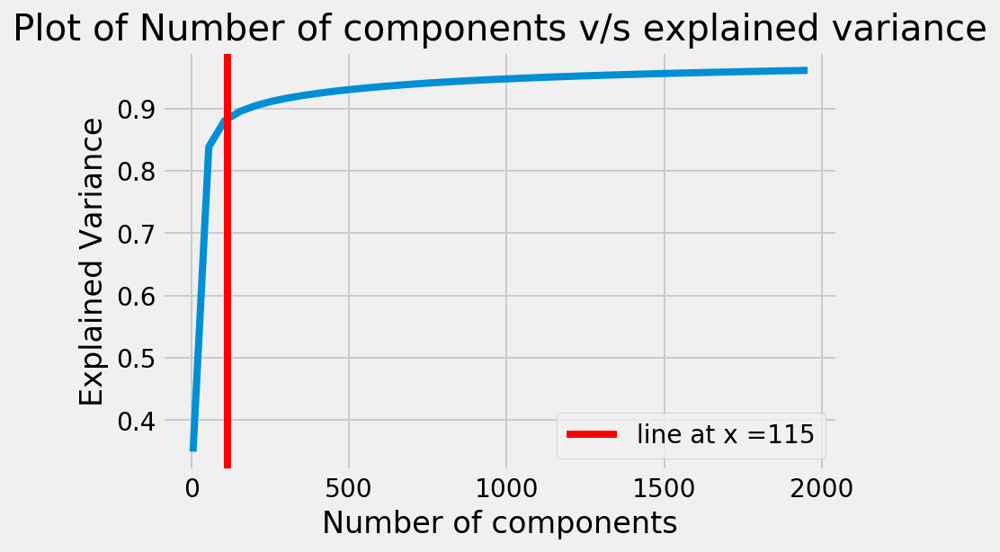

In [66]:
# Plot number of components vs explained variance
plt.plot(n_comp, explained_var_ratio)
plt.xlabel('Number of components')
plt.ylabel("Explained Variance")
plt.title("Plot of Number of components v/s explained variance")


plt.axvline(x=115, c='r',label='line at x =115')
plt.legend()
plt.show()

## Modelling On Time Status
For this model I had extremely unbalanced classes so the baseline model was already giving 92%. After trialling some different models, I found the best one to be the same model used for review score, a random forest with truncated SVD and the same amount of optimal components. This gives an average f-1 score of 96%. The main thing I like about this model is that it improved the 0 classification (an order is delivered late compared to provided expected delivery time) from 8% to 69% which is really good as we do not want to recommend items that are likely to be late.

### Train Test Split and Preprocessing 
* Stratify the split so that the classes are balanced between the splits 
* Check the value counts to find out the baseline as well as check the splits are even

In [93]:
Xd = df.drop(columns = ['delivered_on_time', 'order_id','customer_name','customer_zip_code_prefix','payment_type', 'payment_installments', 'payment_value'])
yd = df['delivered_on_time']

In [94]:
numerical_features_d = Xd.select_dtypes(include = ['int64','float64']).columns.to_list()

In [95]:
numerical_features_d.remove('shipped_on_time')

In [96]:
Xd_train, Xd_test, yd_train, yd_test = train_test_split(Xd, yd, test_size=0.3, stratify=yd)

In [97]:
yd_train.value_counts(normalize=True)

1    0.920056
0    0.079944
Name: delivered_on_time, dtype: float64

In [98]:
yd_test.value_counts(normalize=True)

1    0.920048
0    0.079952
Name: delivered_on_time, dtype: float64

#### Baseline is 92%

In [99]:
ctrans_d = ColumnTransformer([('num', StandardScaler(), numerical_features_d),                                                            
                            ('cat', one_hot, categorical_features.columns)],
                             remainder = 'passthrough')

In [100]:
Xd_train = ctrans_d.fit_transform(Xd_train)

In [101]:
Xd_train.shape

(75090, 32828)

In [102]:
Xd_test = ctrans_d.transform(Xd_test)

In [103]:
Xd_test.shape

(32182, 32828)

### Models

#### Classification

In [39]:

model4.fit(Xd_train, yd_train)
yd_pred = model4.predict(Xd_test)

print("Classification Report:")
print(classification_report(yd_test, yd_pred))

conmat = np.array(confusion_matrix(yd_test, yd_pred, labels=[0,1]))

confusion = pd.DataFrame(conmat, index=['is_0', 'is_1'],
                         columns=['pred_0','pred_1'])
print("Confusion Matrix:")
confusion.head()

Classification Report:
              precision    recall  f1-score   support

           0       0.89      0.57      0.69      2573
           1       0.96      0.99      0.98     29609

    accuracy                           0.96     32182
   macro avg       0.93      0.78      0.84     32182
weighted avg       0.96      0.96      0.96     32182

Confusion Matrix:


,pred_0,pred_1
is_0,1457,1116
is_1,175,29434


* While this model has only improved on the baseline by .04, it has significantly improved the predictions of the 0 classification.

#### SVD Optimisation
* As this model is using Truncated SVD, I want to see what is the optimal number of components for this

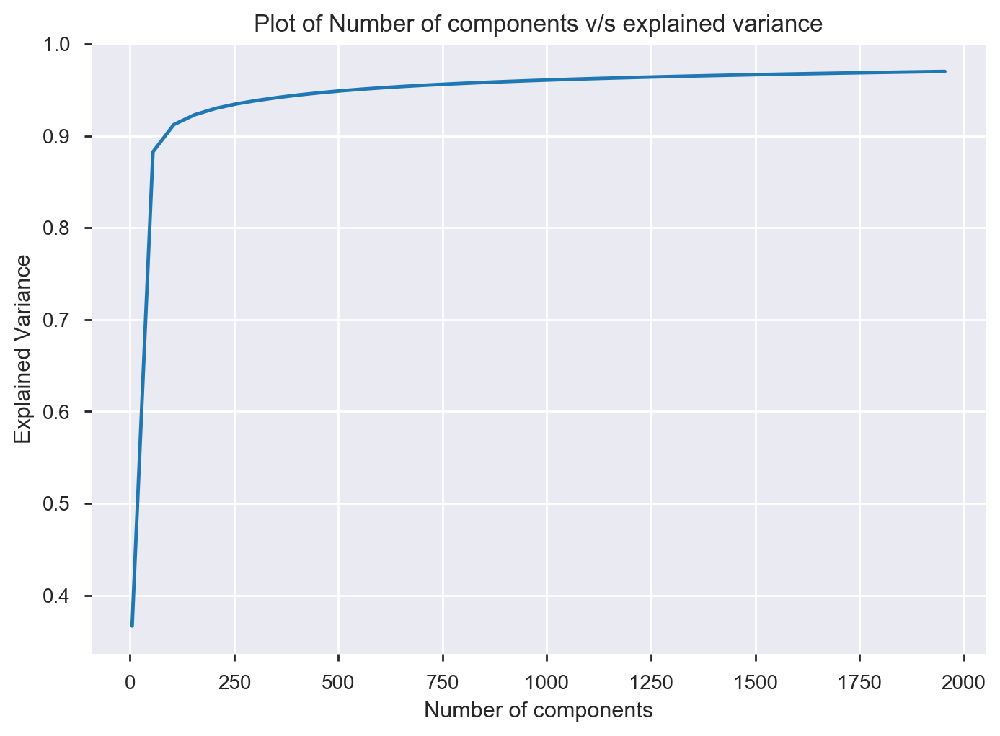

In [127]:
# Create a list containing different values of components
n_comp = [n for n in range(5, 2000, 50)]

# explained variance ratio for each component of Truncated SVD
explained_var_ratio = []

for x in n_comp:
    svd = TruncatedSVD(n_components=x)
    svd.fit(Xd_train)
    explained_var_ratio.append(svd.explained_variance_ratio_.sum())


    # Plot number of components vs explained variance
plt.plot(n_comp, explained_var_ratio)
plt.xlabel('Number of components')
plt.ylabel("Explained Variance")
plt.title("Plot of Number of components v/s explained variance")
plt.show()


* Unsurprisingly, this data has the same optimal components as the review score target data so I can continue to use the same model

##### Component Exploration
* Exploration of the first 10 customers to see what the SVD has done

In [40]:
customer_order = Xd_train[0:10,:]

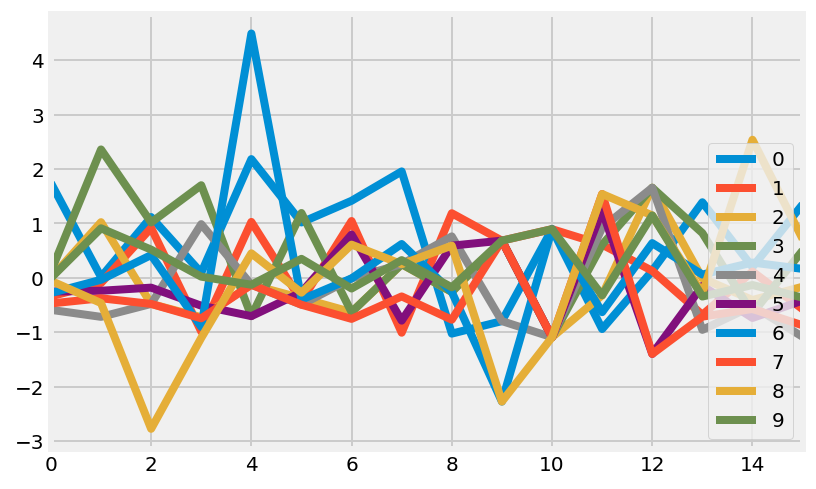

In [41]:
pd.DataFrame(customer_order.todense()[:,:16]).T.plot()

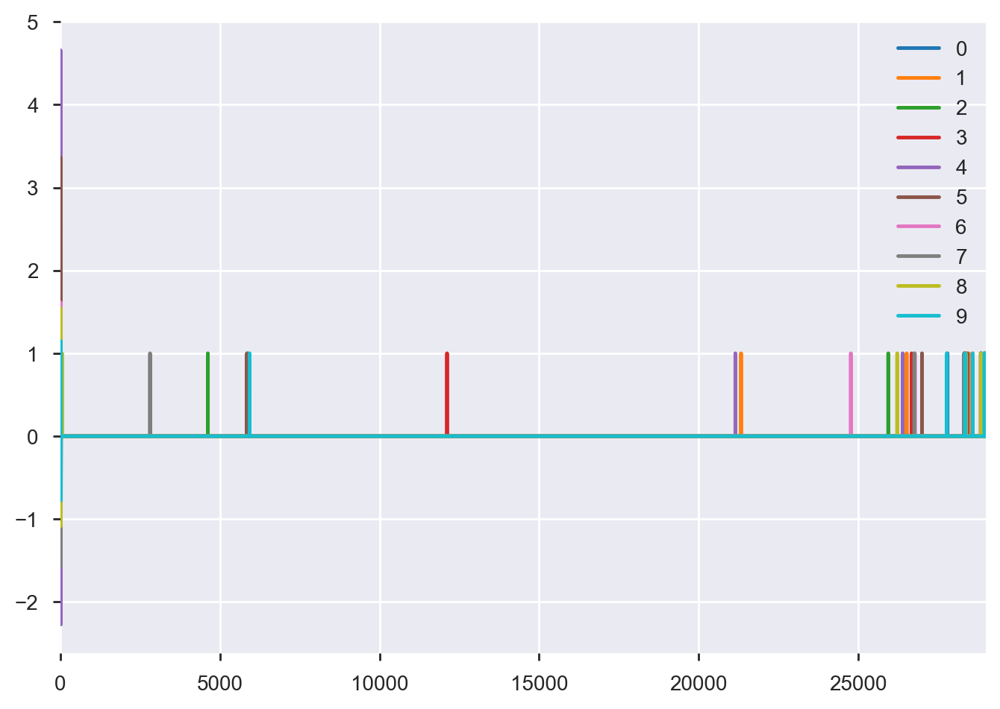

In [200]:
pd.DataFrame(customer_order.todense()[:,:]).T.plot()

Text(0.5, 0, 'Number of components')

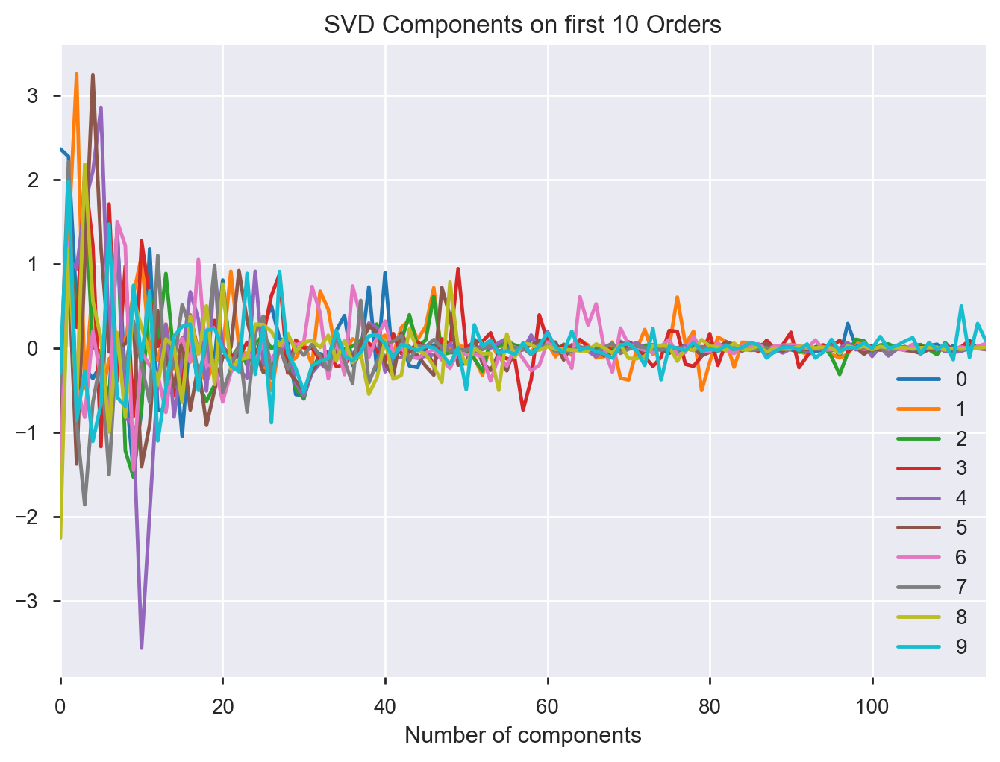

In [246]:
pd.DataFrame(model4['feature selector'].transform(customer_order)[:,:]).T.plot()
plt.title('SVD Components on first 10 Orders')
plt.xlabel('Number of components')

## Clustering
Next I wanted to see if I could use an SVD to reduce the features in order to cluster the customers to recommend purchases based on customers like them. In this case, I was unable to find any well performing clusters so I quickly moved on.

In [30]:
from sklearn import cluster
from sklearn import metrics
from sklearn.preprocessing import scale
from sklearn.cluster import KMeans, k_means
from sklearn.metrics import silhouette_score
from sklearn.metrics import pairwise_distances

In [31]:
df.columns

Index(['order_id', 'price', 'freight_value', 'product_name_len',
       'product_description_len', 'product_photos_qty', 'product_weight_g',
       'product_length_cm', 'product_height_cm', 'product_width_cm',
       'product_category_name_english', 'seller_city', 'seller_state',
       'customer_zip_code_prefix', 'customer_city', 'customer_state',
       'payment_type', 'payment_installments', 'payment_value', 'review_score',
       'order_purchase_year', 'order_purchase_month',
       'order_purchase_dayofweek', 'days_to_customer', 'days_to_carrier',
       'overall_shipping_time', 'shipped_on_time', 'delivered_on_time',
       'category', 'customer_name', 'product_name', 'brand_name'],
      dtype='object')

### Train Test Split and Preprocessing 

In [32]:
Xc = df.drop(columns = ['order_id','customer_zip_code_prefix','customer_name','payment_type', 'payment_installments', 'payment_value'])

In [33]:
categorical_features_c = Xc.select_dtypes(include = 'object')
numerical_features_c = Xc.select_dtypes(include = ['int64','float64']).columns.to_list()

In [34]:
numerical_features_c

['price',
 'freight_value',
 'product_name_len',
 'product_description_len',
 'product_photos_qty',
 'product_weight_g',
 'product_length_cm',
 'product_height_cm',
 'product_width_cm',
 'review_score',
 'order_purchase_year',
 'order_purchase_month',
 'order_purchase_dayofweek',
 'days_to_customer',
 'days_to_carrier',
 'overall_shipping_time',
 'shipped_on_time',
 'delivered_on_time']

In [35]:
numerical_features_c = [x for x in numerical_features_c if x not in ['shipped_on_time','delivered_on_time']]

In [36]:
categorical_features_c.columns

Index(['product_category_name_english', 'seller_city', 'seller_state',
       'customer_city', 'customer_state', 'category', 'product_name',
       'brand_name'],
      dtype='object')

In [40]:
Xc_train, Xc_test = train_test_split(Xc, test_size=0.3)

In [41]:
one_hot_c = OneHotEncoder(handle_unknown='ignore').fit(categorical_features_c)

In [42]:
ctrans_c = ColumnTransformer([('num', StandardScaler(), numerical_features_c),                                                            
                            ('cat', one_hot_c, categorical_features_c.columns)],
                             remainder = 'passthrough')

In [43]:
Xc_train = ctrans_c.fit_transform(Xc_train)

In [44]:
Xc_train.shape

(75090, 32595)

In [45]:
Xc_test = ctrans_c.transform(Xc_test)

In [46]:
Xc_test.shape

(32182, 32595)

In [47]:
svd = TruncatedSVD(n_components=3)
svd.fit(Xc_train)
svd_train = svd.transform(Xc_train)
svd_test = svd.transform(Xc_test)

In [48]:
svds = pd.DataFrame(svd_train)

In [49]:
svds.head()

,0,1,2
0,-1.195028,0.484221,1.205619
1,-2.145208,1.360139,-0.099030
2,-1.958177,0.821608,1.115238
3,-0.017734,1.201721,1.300221
4,-1.969709,0.443878,1.971782


In [50]:
from mpl_toolkits.mplot3d import Axes3D

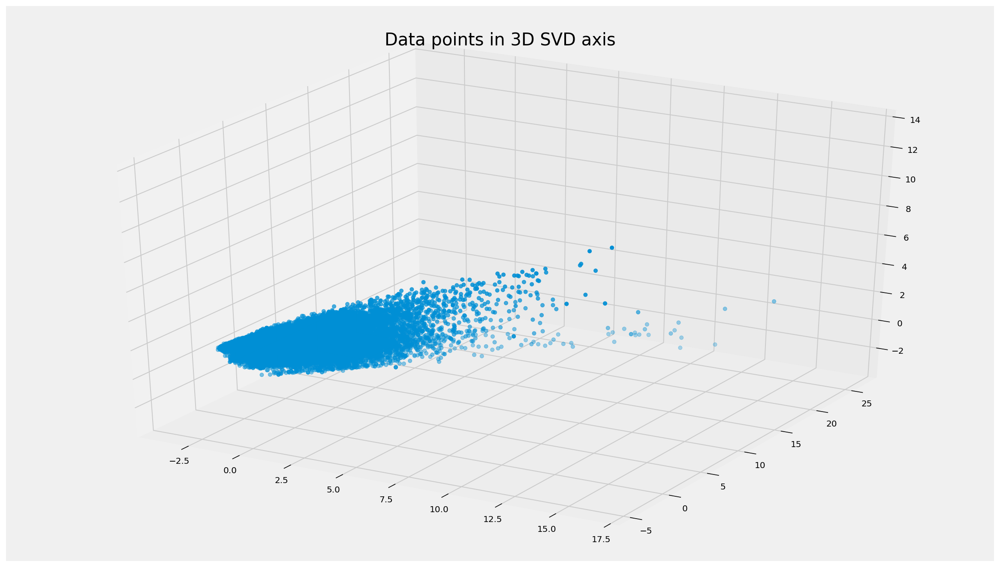

In [51]:
plt.rcParams['figure.figsize'] = (16, 9)


fig = plt.figure()
ax = Axes3D(fig)
ax.scatter(svds[0], svds[2], svds[1])

plt.title('Data points in 3D SVD axis', fontsize=20)
plt.show()

In [52]:
svd.explained_variance_ratio_.sum()

0.23098722770487443

* Again, I want to find the optimal components for this SVD

In [69]:
# Create a list containing different values of components
n_comp = [n for n in range(5, 750, 50)]

# explained variance ratio for each component of Truncated SVD
explained_var_ratio = []

for x in tqdm(n_comp):
    svd = TruncatedSVD(n_components=x)
    svd.fit(Xd_train)
    explained_var_ratio.append(svd.explained_variance_ratio_.sum())


100%|██████████| 15/15 [08:26<00:00, 59.11s/it]


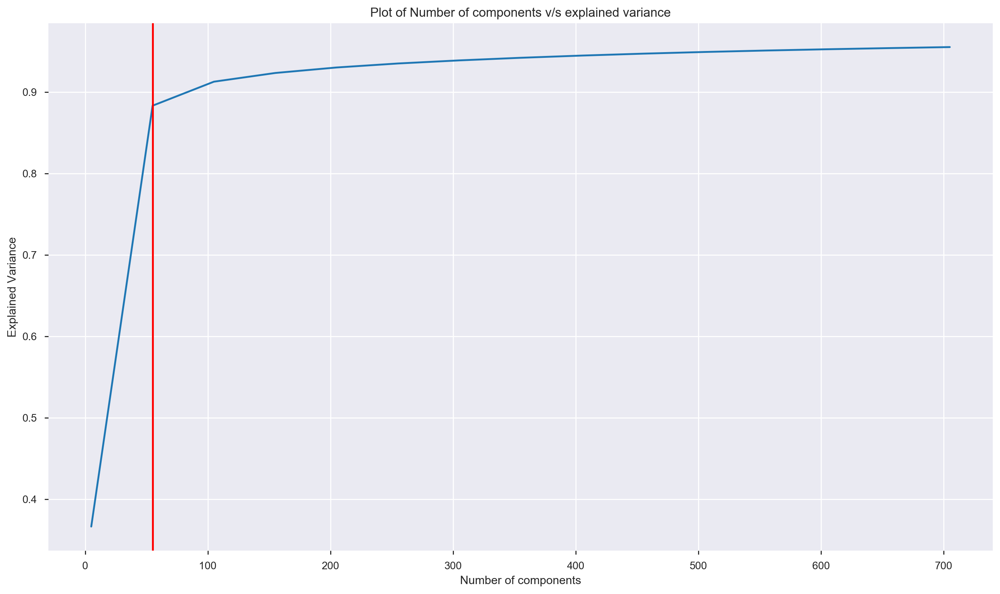

In [244]:
    # Plot number of components vs explained variance
plt.plot(n_comp, explained_var_ratio)
plt.xlabel('Number of components')
plt.ylabel("Explained Variance")
plt.title("Plot of Number of components v/s explained variance")
plt.axvline(x=55, c='r',label='line at x =55')
plt.show()


In [53]:
svd = TruncatedSVD(n_components=55)
svd.fit(Xc_train)
svd_train = svd.transform(Xc_train)
svd_test = svd.transform(Xc_test)

* Now let's find the optimal number of clusters for a kmeans clustering model

In [251]:
scores = []
inertia = []
for i in range(3,11):
    model = KMeans(n_clusters = i)
    model.fit(svd_train)
    predicted = model.labels_
    score = silhouette_score(svd_train, predicted, metric='euclidean')
    scores.append(score)
    inertia.append(model.inertia_)
    print('model'+str(i)+' train silhouette scores: ', score)
   

model3 train silhouette scores:  0.23879674225360947
model4 train silhouette scores:  0.09091566475878517
model5 train silhouette scores:  0.09304720699327895
model6 train silhouette scores:  0.09538677074312339
model7 train silhouette scores:  0.09051794194333235
model8 train silhouette scores:  0.08577026170204324
model9 train silhouette scores:  0.08190509321688556
model10 train silhouette scores:  0.08557001092827005


In [122]:
modelk = KMeans(n_clusters = 10)
modelk.fit(Xd_train)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=10, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

In [123]:
predicted = modelk.labels_

In [124]:
score = silhouette_score(Xd_train, predicted, metric='euclidean')

In [125]:
score

0.0631663877740742

* None of these models are performing well as the data is too sparse, so I will try a different approach. I still want to plot the first 3 SVD components so I can get a general look of how these are compared.

In [54]:
import plotly.express as px

In [55]:
svds.columns = ['SVD1','SVD2','SVD3']

In [56]:
dfm = df.merge(svds,left_index=True,right_index=True)

In [57]:
fig = px.scatter_3d(dfm, x='SVD1', y='SVD2', z='SVD3',
              color='review_score')
fig.update_layout(scene = dict(
                    xaxis = dict(nticks = 10,
                         backgroundcolor="rgb(200, 200, 230)",
                         gridcolor="white",
                         showbackground=True,
                         zerolinecolor="white",),
                    yaxis = dict(nticks = 10,
                        backgroundcolor="rgb(230, 200,230)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white"),
                    zaxis = dict(nticks = 10,
                        backgroundcolor="rgb(230, 230,200)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white",),),
                    width=700,
                    margin=dict(
                    r=10, l=10,
                    b=10, t=10)
                  )
fig.show()

## Customer Segmentation 

After trialling different models and seeing that SVD has worked well on this data, I decided to try and use this technique for a more in depth collaborative filtering model. By using a tfidf vectorizer to count all products purchased in a matrix against all customers, I was able to replicate the weights penalizing the popular products that I had used in my basic model. This time I have all the information in a matrix that can be plugged in to an SVD. After retrieving the most important 1000 components in this SVD, I can take a csoine similarity between any two customers to see how likely they are to order the same items. In this case,it's not as important to calculate the optimal number of components as I am essentially just using it in order to rank each customer in reference to another.

### Tfidf Vectorizer

* In order to get a dataframe of customers against the products they purchased, I decided to try using a TFIDF vectorizer so that it would count the products and also weight them based on their frequency. In this way, I can get the matrix ready for SVD and cosine similarity calculation.

In [58]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.decomposition import TruncatedSVD
from tqdm import tqdm

In [59]:
prod_names = list(df.product_name.unique())
cust_names = list(df.customer_name.unique())
brand_names = list(df.customer_name.unique())

In [60]:
cust_sales = {k:list(cust_prods[k]) for k in list(cust_prods)}

In [61]:
cust_vecs = pd.Series(cust_sales)
cust_vecs = cust_vecs.apply(lambda x : [', '.join(x) for word in [x]][0])

In [62]:
cust_vecs.head(10)

Rodrigo Keefe                limit Lisa
Julianna Queen               limit Lisa
Palmer Bankston              limit Lisa
Lupe Pettigrew               limit Lisa
Genaro Cheatham              limit Lisa
Rod Nesbitt                  limit Lisa
Jarod Morrow                 limit Lisa
Betty Nestor       limit Lisa, aunt leg
Ellis Whittle                limit Lisa
Major Geer            archeology curler
dtype: object

In [63]:
tfidf = TfidfVectorizer(ngram_range=(1,2),vocabulary=prod_names)

In [64]:
cust_tfidfvecs =  pd.DataFrame(tfidf.fit_transform(cust_vecs).todense(),columns=tfidf.get_feature_names())

In [65]:
cust_tfidfvecs.set_index(cust_vecs.index,inplace=True)

In [66]:
cust_tfidfvecs.head(20)

,limit Lisa,archeology curler,aunt leg,rotate macrame,apple lentil,ceramic barber,cafe advertisement,gum chronometer,segment ocean,grip decade,...,effect tent,line skin,statistic trail,squirrel paint,Taurus sky,married metal,tortellini respect,check hardboard,conga Susan,larch chair
Rodrigo Keefe,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Julianna Queen,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Palmer Bankston,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Lupe Pettigrew,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Genaro Cheatham,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Rod Nesbitt,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Jarod Morrow,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Betty Nestor,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Ellis Whittle,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Major Geer,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### SVD


#### 3 Components
* First I want to model the first 3 components and see what they look like before increasing

In [67]:
svd = TruncatedSVD(n_components=3)

In [68]:
cust_svd = svd.fit(tfidf.fit_transform(cust_vecs)) 

In [69]:
cust_svd.components_.shape

(3, 31332)

In [70]:
cust_svds = pd.DataFrame(cust_svd.transform(cust_tfidfvecs))

In [71]:
cust_svds.columns = ['SVD1','SVD2','SVD3']

In [72]:
cust_svds['cust_names'] = cust_names

In [73]:
cust_svds.head()

,SVD1,SVD2,SVD3,cust_names
0,0.0,0.0,0.0,Rodrigo Keefe
1,0.0,0.0,0.0,Julianna Queen
2,0.0,0.0,0.0,Palmer Bankston
3,0.0,0.0,0.0,Lupe Pettigrew
4,0.0,0.0,0.0,Genaro Cheatham


In [74]:
fig = px.scatter_3d(cust_svds, x='SVD1', y='SVD2', z='SVD3')
fig.show()

In [76]:
cust_svds[cust_svds.cust_names.isin(['Chris Baldwin','Lupe Pettigrew'])][['cust_names','SVD1','SVD2','SVD3']]

,cust_names,SVD1,SVD2,SVD3
3,Lupe Pettigrew,0.000000e+00,0.000000e+00,0.000000e+00
15,Chris Baldwin,-4.468251e-14,-4.567562e-14,-2.277429e-14


In [77]:
cosine_similarity(cust_svds[cust_svds.cust_names == 'Chris Baldwin'][['SVD1','SVD2','SVD3']],
                  cust_svds[cust_svds.cust_names == 'Lupe Pettigrew'][['SVD1','SVD2','SVD3']])[0][0]

0.0

In [78]:
cust_svds[cust_svds.cust_names == 'Chris Baldwin'].iloc[:,0:-1]

,SVD1,SVD2,SVD3
15,-4.468251e-14,-4.567562e-14,-2.277429e-14


* Creation of a dictionary of cosine similarity between Chris Baldwin and all other customers

In [79]:
cosine_scores = {}
for n in tqdm(cust_prods):
    cosine_scores[n] = cosine_similarity(cust_svds[cust_svds.cust_names == 'Chris Baldwin'][['SVD1','SVD2','SVD3']],
                                         cust_svds[cust_svds.cust_names == n][['SVD1','SVD2','SVD3']])[0][0]

100%|██████████| 91593/91593 [32:03<00:00, 47.61it/s] 


* Compare the cosine similarities scores to the weights calculated for the same customer using the weighted jaccard measure

In [ ]:
sorted(cosine_scores.items(), key=lambda kv: kv[1], reverse=True)

In [ ]:
sorted(weights.items(), key=lambda kv: kv[1], reverse=True)

#### Higher Components
* Now I want to try the same process with more components so that the points are more scattered

In [ ]:
svd2 = TruncatedSVD(n_components=1000)

cust_svd2 = svd2.fit(tfidf.fit_transform(cust_vecs)) 

print(cust_svd2.explained_variance_ratio_.sum())
print(cust_svd2.components_.shape)

In [ ]:
cust_svds2 = pd.DataFrame(cust_svd2.transform(cust_tfidfvecs))

* By rounding all the values, I am hoping I can reduce some run time as it is currently taking half an hour to collect one customers similarity scores with all other customers

In [ ]:
cust_svds2 = cust_svds2.apply(lambda x: round(x,5))

In [ ]:
cust_svds2['cust_names'] = cust_names

cust_svds2.head(20)

In [ ]:
cosine_similarity(cust_svds2[cust_svds2.cust_names == 'Chris Baldwin'].iloc[:,0:-1],
                  cust_svds2[cust_svds2.cust_names == 'Lupe Pettigrew'].iloc[:,0:-1])[0][0]

In [ ]:
cosine_scores2 = {}
for n in tqdm(cust_prods):
    cosine_scores2[n] = cosine_similarity(cust_svds2[cust_svds2.cust_names == 'Chris Baldwin'].iloc[:,0:-1],
                                         cust_svds2[cust_svds2.cust_names == n].iloc[:,0:-1])[0][0]

In [ ]:
sorted(cosine_scores2.items(), key=lambda kv: kv[1], reverse=True)

## Intermediate Recommendation Engine

Now that I have the method by which to calculate the similarities between each customer, I need to go about the task of actually doing so. For each customer, to calculate all other customers and their cosine simlarity it takes around half an hour. This means that in order to get a starting database of all customers, it will take 127 days as I have 90,000+ unique customers in the database. In order to be able to only have to do this task once, the best method is to create a clustered dictionary with each customer as the key and then the value be a dictionary of the similarities with all other customers. This way when a new customer purchases something, it would only need that half hour calculation and a further calculation to insert into all other customers' dictionaries. Up until this point, this new customers recommendations will be made using other metrics such as most popular items for their demographic etc. It also means this calculation does not need to be done on the spot as recommendations need to be made instantaneously. This initial processing time and general data storage capacity is one of the biggest factors to take into consideration when creating a recommendation such as this.

Once you have this dictionary per customer of their similarities to other customers, the model is really simple. It sorts the dictionary to find the most similar customers and then recommends based on which items those similar customers have bought which the key customer has not yet purchased.

### Customer similarity dictionary creation

In [ ]:
cust_cosine = {}
cust_cosine['Chris Baldwin'] = cosine_scores2

In [ ]:
pprint(cust_cosine)

In [ ]:
# each iteration takes around half an hour so it would take ~ 4 months to create this entire dictionary
# so for this project I will only start with 10 customers and go from there

cust_cosine = {}
for cust in tqdm(islice(cust_prods,7,18)):
    cosine_scores = {}
    for n in cust_prods:
        cosine_scores[n] = cosine_similarity(cust_svds[cust_svds.cust_names == cust].iloc[:,0:-1],
                                             cust_svds[cust_svds.cust_names == n].iloc[:,0:-1])[0][0]
    cust_cosine[cust] = cosine_scores  

In [ ]:
# now I will save to Json file for future reference
import json

with open('/Users/elkehansen/Documents/general_assembly/Capstone-Subsmission/Elke/datasets/cust_cosine.json', 'w') as fp:
    json.dump(cust_cosine, fp)
    

In [ ]:
with open('./datasets/cust_cosine.json', 'r') as fp:
    data = json.load(fp)

### Recommendations
* Adjustment of previous recommender to suit the new dictionary storage method

In [ ]:
def recommend_for_prods2(customer, customer_dict = cust_cosine):
    """
    Return top five recommended products
      based on the brands in 'prods_set'.
      
    Takes a set of product names.  
    """
    #creation of a dictionary of each users weighted score against the brands set
    weights = cust_cosine[customer]

    
    #sorting the weighted dictionary by the weight    
    sorted_w = sorted(weights.items(), key=lambda kv: kv[1], reverse=True) 

    
    #creation of a set so the same product doesn't get added multiple times
    unique_prods = set()
    
    for i in sorted_w:
        if i[1] == 1:
            pass
        else:
            for prod in cust_prods[i[0]]:
                    if len(unique_prods) == 5:
                        break
                    elif prod in cust_prods[customer]:
                        break
                    else:
                        unique_prods.add(prod)
                                       
    return unique_prods
    